# IMDB Midterm Project
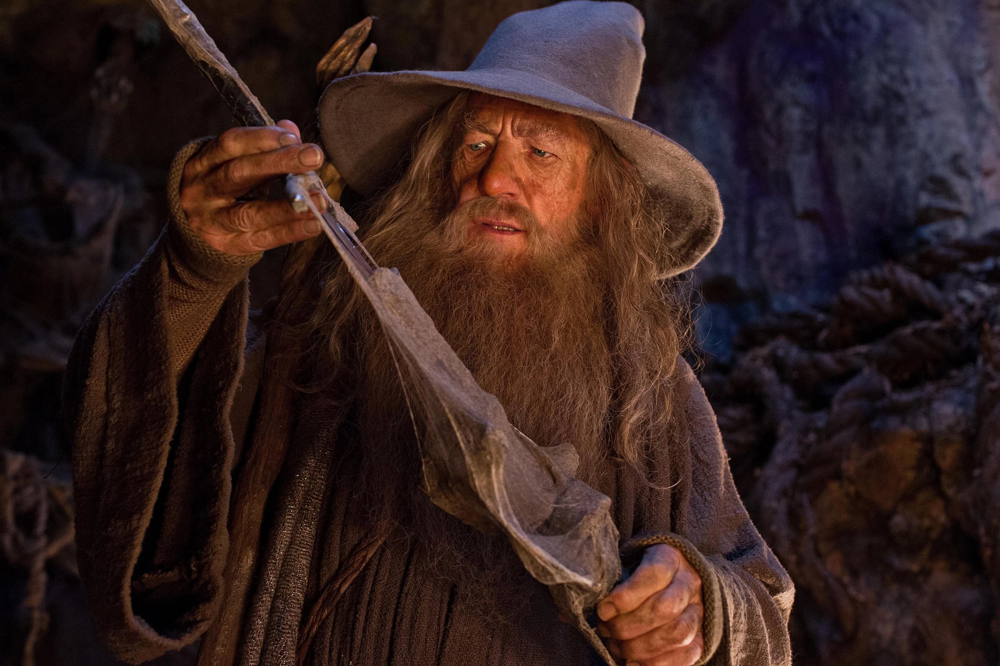

In this project, we will be exploring a dataset with information on about 86,000 movies tracked by IMDB. The dataset link is at https://www.kaggle.com/stefanoleone992/imdb-extensive-dataset, but I will provide the needed files: 
- IMDB movies.csv, which contains attributes such as movie description, average rating, number of votes, genre, etc.
- IMDB ratings.csv, which contains rating details from demographic perspective
<br>
<br>
<b>All questions require that the task be done via programming. In other words, no loading into Excel and tinkering with things until you get an answer (unless you want to check an answer).</b>

First, import numpy, pandas and seaborn. Also import pyplot as plt from matplotlib. Set the Seaborn style to darkgrid.

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt 
%matplotlib inline
sns.set_style('darkgrid')

C:\Users\jdorick\AppData\Roaming\Python\Python37\site-packages\pandas\compat\_optional.py:138: UserWarning: Pandas requires version '2.7.0' or newer of 'numexpr' (version '2.6.9' currently installed).
  warnings.warn(msg, UserWarning)


Now read both files into pandas DataFrames. The encoding type is 'unicode_escape'.

In [3]:
movies = pd.read_csv('./data/IMDB movies.csv', sep=',', index_col=0,encoding='unicode_escape')
ratings = pd.read_csv('./data/IMDB ratings.csv', sep=',', index_col=0,encoding = 'unicode_escape')

Find the shape and size, then use the describe function on the two files to get an idea of what the data looks like.

In [4]:
print(movies.size, movies.shape)
print(ratings.size, ratings.shape)
print(movies.describe())
ratings.describe()

1573720 (78686, 20)
343420 (85855, 4)
               year      duration      avg_vote         votes     budget($)  \
count  78686.000000  78686.000000  78686.000000  7.868600e+04  1.660200e+04   
mean    1992.379178     99.888570      5.891444  9.908286e+03  1.439146e+07   
std       24.616883     22.298296      1.232927  5.527097e+04  2.889929e+07   
min     1894.000000     41.000000      1.000000  9.900000e+01  0.000000e+00   
25%     1977.000000     88.000000      5.200000  2.020000e+02  7.500000e+05   
50%     2001.000000     96.000000      6.100000  4.750000e+02  3.000000e+06   
75%     2012.000000    108.000000      6.800000  1.739750e+03  1.500000e+07   
max     2020.000000    808.000000      9.900000  2.278845e+06  3.560000e+08   

       worldwide_gross_income     metascore  reviews_from_users  \
count            2.721800e+04  12520.000000        71969.000000   
mean             2.488829e+07     55.437620           47.777265   
std              9.405843e+07     17.784523      

,weighted_average_vote,total_votes,mean_vote,median_vote
count,85855.000000,8.585500e+04,85855.000000,85855.000000
mean,5.898656,9.493490e+03,6.226342,6.267853
std,1.234987,5.357436e+04,1.155280,1.481168
min,1.000000,9.900000e+01,1.000000,1.000000
25%,5.200000,2.050000e+02,5.600000,6.000000
50%,6.100000,4.840000e+02,6.400000,6.000000
75%,6.800000,1.766500e+03,7.000000,7.000000
max,9.900000,2.278845e+06,9.800000,10.000000


How many missing values are there in each column of the movies file?

In [5]:
movies.isna().sum()

original_title                0
year                          0
date_published                0
genre                         0
duration                      0
country                      64
language                    799
director                     82
writer                     1429
production_company         4230
actors                       67
description                1893
avg_vote                      0
votes                         0
budget($)                 62084
usa_gross_income          64206
worldwide_gross_income    51468
metascore                 66166
reviews_from_users         6717
reviews_from_critics      10705
dtype: int64

Create a new DataFrame that retains only the movies where the country column contains USA in the movies csv. Be careful. Some movies were released in multiple countries, so make sure that we keep those too if one of those countries was the USA. I've done the first step in removing rows with no country specified.

In [6]:
movies = movies[movies['country'].notna()]
USA_movies = movies[movies['country'].str.contains('USA')]

Next, we can drop some columns that we won't be using for this analysis.

In the movies csv, drop the following columns:
- date_published
- writer
- production_company
- actors
- description

In [7]:
USA_movies = USA_movies.drop(columns=['date_published','writer','production_company','actors','description'])

We won't do any filter on the ratings file because they're mostly numerical values that don't take up much memory.

Next, we'll need to join together the two files. imdb_title_id is the column that is common to both files and is what we will use to join the data.<br>
<br>
Let's call it df_merged. To do so, use the following:
df_merged = df_usa_movies.join(df_ratings, on='imdb_title_id')
<br>
Now use the head command to see that they were joined properly.

In [8]:
df_merged = USA_movies.join(ratings, on='imdb_title_id')
df_merged.head()

,original_title,year,genre,duration,country,language,director,avg_vote,votes,budget($),usa_gross_income,worldwide_gross_income,metascore,reviews_from_users,reviews_from_critics,weighted_average_vote,total_votes,mean_vote,median_vote
imdb_title_id,,,,,,,,,,,,,,,,,,,
tt0041452,The Heiress,1949,"Drama, Romance",115,USA,"English, French",William Wyler,8.1,13301,2600000.0,NaN,16.0,NaN,140.0,61.0,8.1,13301,8.2,8.0
tt0429277,Zyzzyx Rd,2006,"Crime, Drama, Thriller",90,USA,English,John Penney,4.1,983,2000000.0,$30,30.0,NaN,11.0,2.0,4.1,983,4.5,4.0
tt0932669,Older Than America,2008,Drama,102,USA,English,Georgina Lightning,5.3,857,1000000.0,NaN,32.0,NaN,24.0,6.0,5.3,857,5.8,6.0
tt5978724,My Days of Mercy,2017,"Drama, Romance",108,"UK, USA",English,Tali Shalom-Ezer,6.4,2754,NaN,NaN,51.0,NaN,27.0,21.0,6.4,2754,6.6,7.0
tt0066542,A Walk in the Spring Rain,1970,"Drama, Romance",98,USA,English,Guy Green,6.1,647,NaN,NaN,52.0,NaN,13.0,4.0,6.1,647,7.1,7.0


What percent of movies in this dataset had 100000 or more ratings?

In [9]:
df_merged[df_merged['total_votes'] >= 100000]['total_votes'].count() / df_merged['total_votes'].count() * 100

5.0181839511966215

In the last pre-processing step, let's remove any movies that have less than 100000 ratings (total_votes). From this point onwards, this will be the dataset that we will use.

In [10]:
df_merged_ratings = df_merged[df_merged['total_votes'] >= 100000]

For the rest of the notebook, it would be helpful to know all column names. Print them out here.

In [11]:
df_merged_ratings.columns.tolist()

['original_title',
 'year',
 'genre',
 'duration',
 'country',
 'language',
 'director',
 'avg_vote',
 'votes',
 'budget($)',
 'usa_gross_income',
 'worldwide_gross_income',
 'metascore',
 'reviews_from_users',
 'reviews_from_critics',
 'weighted_average_vote',
 'total_votes',
 'mean_vote',
 'median_vote']

Find the 25 movies with the highest average vote (avg_vote).

In [12]:
df_merged_ratings.sort_values(by='avg_vote', ascending=False).head(25)

,original_title,year,genre,duration,country,language,director,avg_vote,votes,budget($),usa_gross_income,worldwide_gross_income,metascore,reviews_from_users,reviews_from_critics,weighted_average_vote,total_votes,mean_vote,median_vote
imdb_title_id,,,,,,,,,,,,,,,,,,,
tt0111161,The Shawshank Redemption,1994,Drama,142,USA,English,Frank Darabont,9.3,2278845,25000000.0,"$28,699,976",2.881524e+07,80.0,8232.0,164.0,9.3,2278845,9.1,10.0
tt0068646,The Godfather,1972,"Crime, Drama",175,USA,"English, Italian, Latin",Francis Ford Coppola,9.2,1572674,6000000.0,"$134,966,411",2.461210e+08,100.0,3977.0,253.0,9.2,1572674,8.9,10.0
tt0071562,The Godfather: Part II,1974,"Crime, Drama",202,USA,"English, Italian, Spanish, Latin, Sicilian",Francis Ford Coppola,9.0,1098714,13000000.0,"$47,834,595",4.803578e+07,90.0,1030.0,178.0,9.0,1098714,8.8,9.0
tt0468569,The Dark Knight,2008,"Action, Crime, Drama",152,"USA, UK","English, Mandarin",Christopher Nolan,9.0,2241615,185000000.0,"$535,234,033",1.005455e+09,84.0,6938.0,423.0,9.0,2241615,8.9,9.0
tt0050083,12 Angry Men,1957,"Crime, Drama",96,USA,English,Sidney Lumet,8.9,668473,350000.0,NaN,5.760000e+02,96.0,1605.0,149.0,8.9,668473,8.8,9.0
tt0167260,The Lord of the Rings: The Return of the King,2003,"Action, Adventure, Drama",201,"New Zealand, USA","English, Quenya, Old English, Sindarin",Peter Jackson,8.9,1604280,94000000.0,"$377,845,905",1.142271e+09,94.0,3718.0,353.0,8.9,1604280,8.8,9.0
tt0110912,Pulp Fiction,1994,"Crime, Drama",154,USA,"English, Spanish, French",Quentin Tarantino,8.9,1780147,8000000.0,"$107,928,762",2.228318e+08,94.0,3058.0,289.0,8.9,1780147,8.7,9.0
tt0108052,Schindler's List,1993,"Biography, Drama, History",195,USA,"English, Hebrew, German, Polish, Latin",Steven Spielberg,8.9,1183248,22000000.0,"$96,898,818",3.222878e+08,94.0,1845.0,232.0,8.9,1183248,8.7,9.0
tt1375666,Inception,2010,"Action, Adventure, Sci-Fi",148,"USA, UK","English, Japanese, French",Christopher Nolan,8.8,2002816,160000000.0,"$292,576,195",8.697850e+08,74.0,3927.0,473.0,8.8,2002816,8.7,9.0


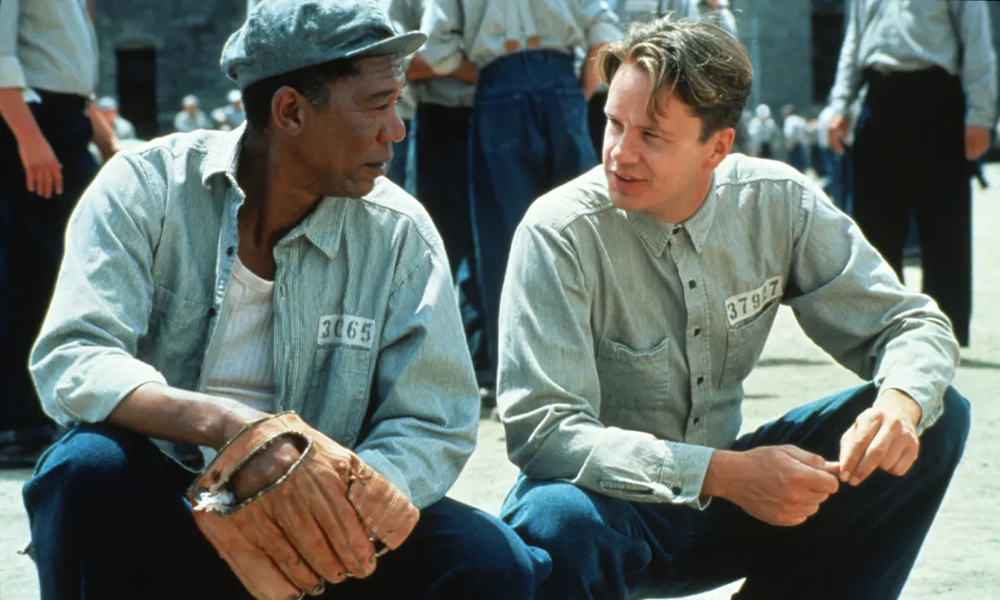

Which of these top 25 movies have you seen? Do you agree with the high rating?

I have seen Pulp Fiction, Goodfellas, Se7en, Star Wars, and Psycho. I agree with Shawshank Redemption having the highest rating, I have heard amazing things about the movie despite me not seeing it yet.

Make a histogram in Seaborn examining the distribution of average movie ratings (avg_vote) across the dataset. Use 20 bins.

Text(0.5, 0, 'Average Rating')

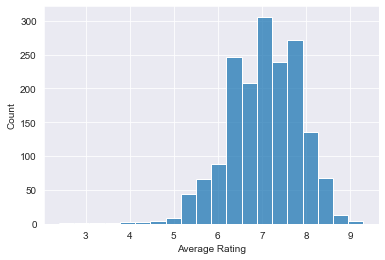

In [13]:
sns.histplot(data=df_merged_ratings, x="avg_vote", bins=20)
plt.xlabel('Average Rating')

Create a scatter plot using Seaborn to examine mean movie rating as a function of release year. Include a trendline.

Text(28.05000000000001, 0.5, 'Mean Vote')

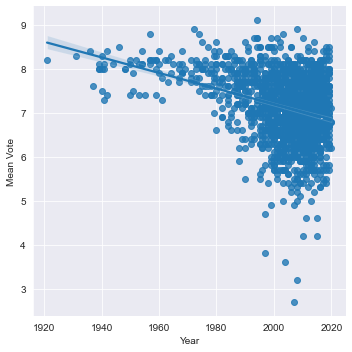

In [14]:
sns.lmplot(data=df_merged_ratings,x='year',y='mean_vote')
plt.xlabel('Year')
plt.ylabel('Mean Vote')

What does the plot show? What sort of bias may there be for movies released a long time ago?

The bias there may be for movies released a long time ago is that there were not many movies to compare to each other and would then be seen as better overall. 

Find the genre with the highest average budget.

In [15]:
df_merged_ratings[['genre','budget($)']].groupby('genre',as_index=False).mean().sort_values(by='budget($)',ascending=False).head()

,genre,budget($)
78,"Adventure, Fantasy",2.183333e+08
171,"Drama, History",1.750000e+08
21,"Action, Comedy, Sci-Fi",1.700000e+08
5,"Action, Adventure, Family",1.616667e+08
7,"Action, Adventure, History",1.600000e+08


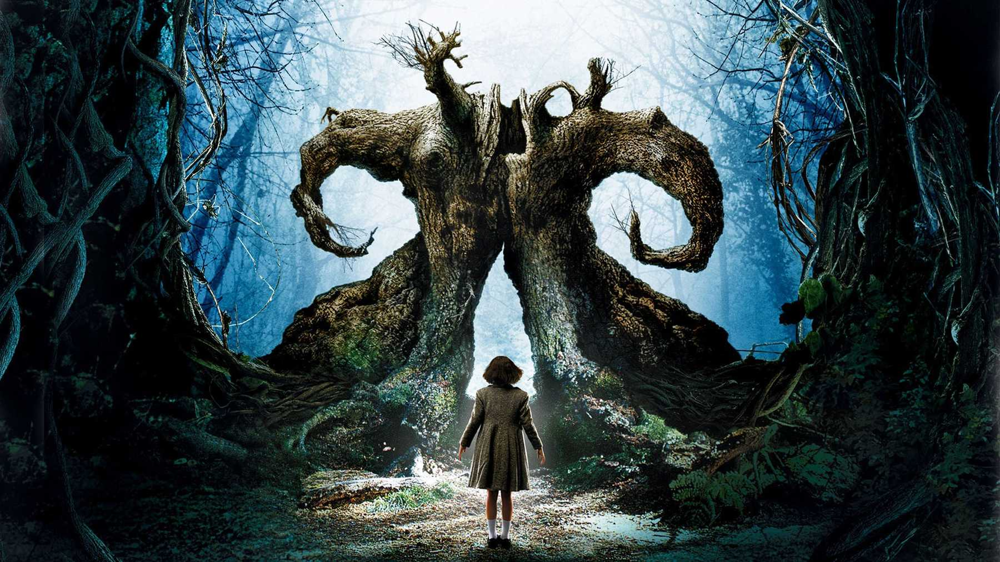

Find the average budget of the top 25 rated movies (by avg_vote) in the dataset.

In [16]:
df_merged_ratings.sort_values('avg_vote',ascending=False).head(25)['budget($)'].mean()

51573477.88

What percentage of movies had a worldwide gross income larger than their budget?

In [21]:
df_merged[(df_merged['worldwide_gross_income'] > df_merged['budget($)'])]['worldwide_gross_income'].count() / df_merged['worldwide_gross_income'].count() * 100

35.693267944716894

This seems higher than expected. It would seem that these companies should make a lot more movies. What bias do you think we're seeing here?

The bias that can be seen here is that a lot of larger companies may make many movies knowing that a large number of audiences will come see the movies. These companies have profits that can be spent on advertising that will result in larger worldwide gross incomes.

Make a jointplot in Seaborn examining the worldwide gross income as a function of budget.

Text(29.125, 0.5, 'Worldwide Gross Income')

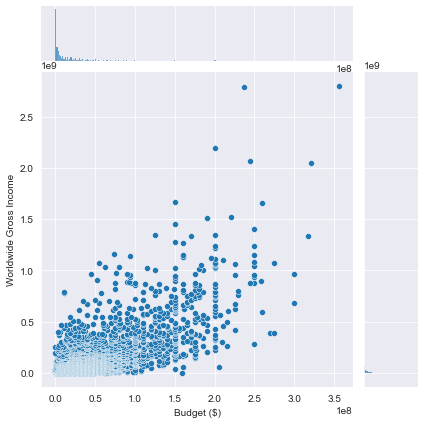

In [23]:
sns.jointplot(data = df_merged, x='budget($)', y='worldwide_gross_income')
plt.xlabel('Budget ($)')
plt.ylabel('Worldwide Gross Income')

Find the top 10 polarizing movies (biggest difference between 'mean_vote' and 'median_vote). This is not mathematically sound, but about the best we can do with these columns.

In [25]:
df_merged['polarization'] = abs(df_merged['mean_vote'] - df_merged['median_vote'])
df_merged.sort_values('polarization', ascending = False).head(10)

,original_title,year,genre,duration,country,language,director,avg_vote,votes,budget($),usa_gross_income,worldwide_gross_income,metascore,reviews_from_users,reviews_from_critics,weighted_average_vote,total_votes,mean_vote,median_vote,polarization
imdb_title_id,,,,,,,,,,,,,,,,,,,,
tt9004516,Zoo Wars 2,2019,Animation,84,USA,English,"James Snider, Evan Tramel",2.3,193,NaN,NaN,17064.0,NaN,8.0,1.0,2.3,193,6.0,10.0,4.0
tt4776998,The Promise,2016,"Action, Adventure, Drama",133,"Spain, USA","English, Armenian, German, French, Turkish",Terry George,6.0,167369,90000000.0,"$8,224,288",12448676.0,49.0,765.0,218.0,6.0,167369,6.1,10.0,3.9
tt3781762,1915,2015,Drama,82,USA,English,"Garin Hovannisian, Alec Mouhibian",4.3,4512,NaN,"$111,682",111682.0,NaN,24.0,7.0,4.3,4512,6.1,10.0,3.9
tt1282134,Beck '08: Unelectable,2008,Comedy,120,USA,English,David Stern,3.7,102,NaN,NaN,NaN,NaN,NaN,NaN,3.7,102,4.5,1.0,3.5
tt0059464,Monster a-Go Go,1965,"Horror, Sci-Fi",70,USA,English,"Bill Rebane, Herschell Gordon Lewis",2.2,7914,NaN,NaN,NaN,NaN,116.0,49.0,2.2,7914,4.3,1.0,3.3
tt8235296,The Trump Prophecy,2018,Drama,120,USA,English,Stephan Schultze,2.5,1551,NaN,"$671,198",671198.0,NaN,42.0,4.0,2.5,1551,4.3,1.0,3.3
tt0058615,The Starfighters,1964,Drama,78,USA,English,Will Zens,2.1,3225,NaN,NaN,NaN,NaN,40.0,4.0,2.1,3225,4.2,1.0,3.2
tt8196068,Twisted Pair,2018,"Drama, Fantasy, Sci-Fi",89,USA,English,Neil Breen,5.9,1313,3.0,NaN,NaN,NaN,69.0,4.0,5.9,1313,6.8,10.0,3.2
tt4065010,Dawn of Destruction,2014,Sci-Fi,85,"USA, Australia","English, French",Neil Johnson,6.1,117,120000.0,NaN,NaN,NaN,NaN,NaN,6.1,117,5.8,9.0,3.2


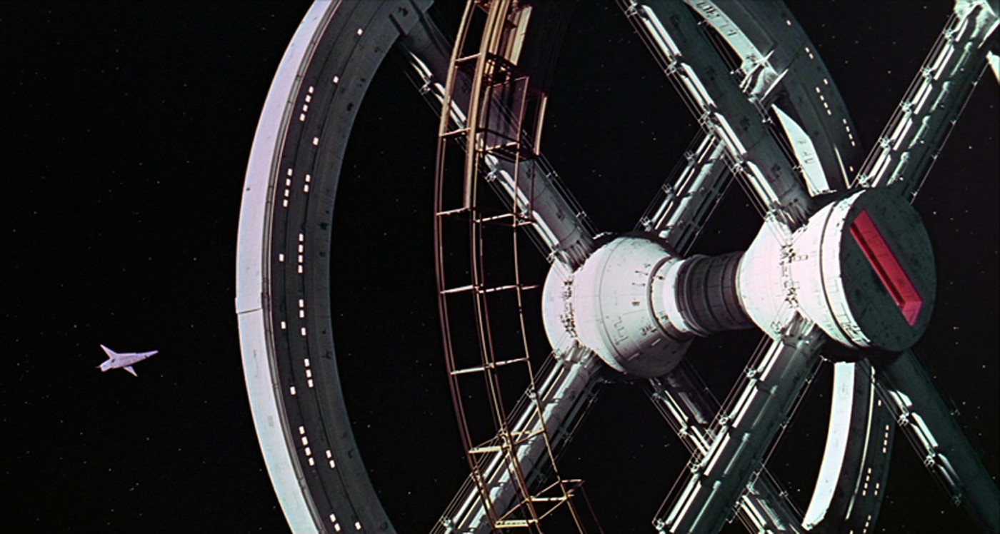

Make a violinplot examining the distribution of metascore by year for movies released since 1980. Change the size of it so that it's easily viewable in Jupyter notebook.

<AxesSubplot:xlabel='year', ylabel='metascore'>

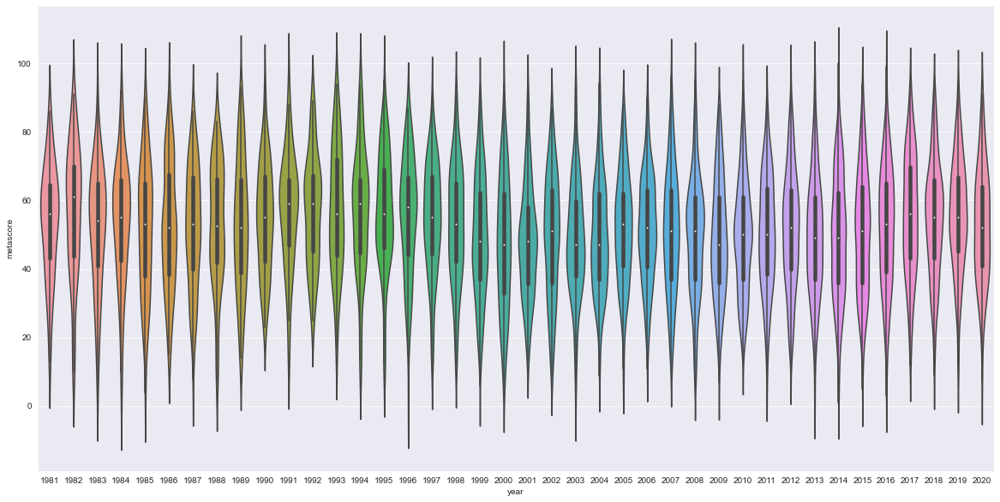

In [36]:
after_1980 = df_merged[df_merged['year'] > 1980]
plt.figure(figsize=(20, 10))
sns.violinplot(data=after_1980,x='year',y='metascore')

Make a swarmplot with year on the x-axis and rating on the y-axis for movies released since 1980. Change the size of it so that it's easily viewable in Jupyter notebook.

<AxesSubplot:xlabel='year', ylabel='avg_vote'>

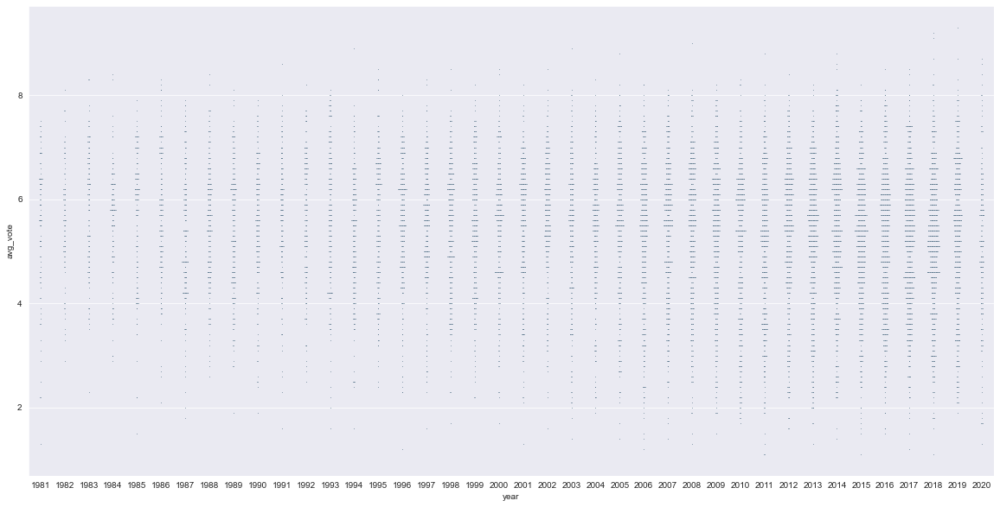

In [41]:
plt.figure(figsize=(20,10))
sns.swarmplot(data=after_1980[::2],x='year',y='avg_vote',size=.6)

Looking at the two previous plots, is there a difference in the trends of metascore vs. avg_vote over time?

The metascore fluctuates slightly while staying around the same area while the average vote decreases slightly over time.